In [7]:
import os, shutil, sys, datetime
# os.environ['CUDA_VISIBLE_DEVICES'] = '-1'

import numpy as np
import numpy.random as rand
from matplotlib import pyplot as mp, patches as patches
from keras import backend as K, preprocessing as kpre, \
                  datasets as kdat, models as kmod, \
                  layers as klay, optimizers as kopt, \
                  utils as kutil, callbacks as kcall, \
                  initializers as kinit, activations as kact, \
                  regularizers as kreg, applications as kapp
import tensorflow as tf
import cv2 as cv
from tqdm import tnrange, tqdm_notebook as tqdm
from keras_tqdm import TQDMNotebookCallback as ktqdm
from jupyterthemes import jtplot

In [2]:
# tf.enable_eager_execution()
jtplot.style()
mp.style.use("seaborn")
mp.rcParams["axes.axisbelow"] = True
mp.rcParams["text.usetex"] = True
mp.rcParams["font.family"] = "serif"
mp.rcParams["figure.figsize"] = (16/2, 9/2)
mp.rcParams["figure.dpi"] = 100
mp.rcParams["text.latex.preamble"] = [r"\usepackage{physics}"]

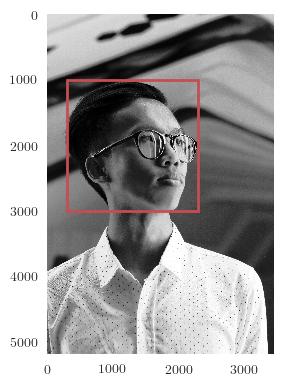

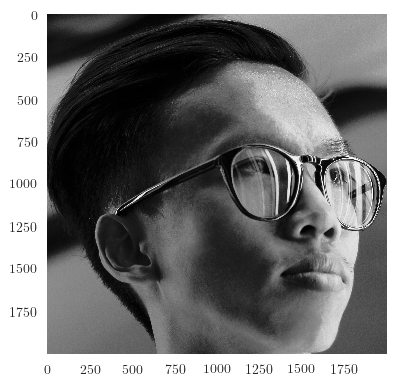

In [3]:
self_portrait = cv.imread('Portraits_BGC_04.jpg', 0)
self_portrait = cv.equalizeHist(self_portrait)

fig = mp.figure()
ax = fig.add_subplot(111)
ax.imshow(self_portrait, 'gray')
rect = patches.Rectangle((300, 1000), 2000, 2000, 
                        facecolor='None', edgecolor='r', alpha=1.0,
                        lw=2)
ax.add_patch(rect)
mp.grid(False)
mp.show()

mp.imshow(self_portrait[1000:3000, 300:2300], 'gray')
mp.grid(False)
mp.show()

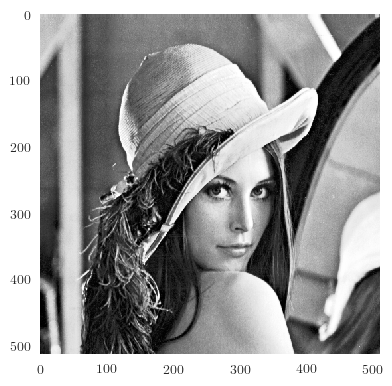

In [4]:
lena = cv.imread('lena.png', 0)
lena = cv.equalizeHist(lena)
mp.imshow(lena, 'gray')
mp.grid(False)
mp.show()

In [5]:
port_train = cv.resize(self_portrait[1000:3000, 300:2300], (64, 64))
lena_train = cv.resize(lena, (64, 64))

x_train0 = np.zeros((2, 64, 64), 'uint8')
x_train0[0] = port_train
x_train0[1] = lena_train
x_train0 = np.expand_dims(x_train0, -1)

In [ ]:
(x_train, y_train), (x_test, y_test) = kdat.mnist.load_data()

x_train0 = np.zeros((4, 28, 28))
for i in range(4):
    x_train0[i] = x_train[y_train==i][0]
x_train0 = np.expand_dims(x_train0, -1)

In [8]:
sessiondir = '{}/'.format(datetime.datetime.now().strftime('%Y%m%d'))
img_w = x_train0.shape[1]
img_h = x_train0.shape[2]
img_ch = 1
batch_size = 2
epochs = int(1e6)

In [10]:
def hlms_initializer(shape, dtype=None, std=0.2):
    return K.random_normal(shape, dtype=dtype)

class Hebbian(klay.Layer):
    def __init__(self, 
                 output_dim, 
                 gamma=1.0, 
                 lr=5e-4, 
                 activation='tanh',
                 use_bias=True,
                 kernel_initializer=hlms_initializer,
                 bias_initializer='zeros',
                 **kwargs):
        '''
        Constructor for the Hebbian learning layer.
        args:
            output_dim - The shape of the output / activations computed by the layer.
            gamma - A floating-point valued parameter governing the strength of the Hebbian learning activation.
            lr - A floating-point valued parameter governing the Hebbian learning rate.
            connectivity - A string which determines the way in which the neurons in this layer are connected to
            the neurons in the previous layer.
        '''
        if 'input_shape' not in kwargs and 'input_dim' in kwargs:
            kwargs['input_shape'] = (kwargs.pop('input_dim'),)
        self.output_dim = output_dim
        self.gamma = gamma
        self.lr = lr
        self.activation = kact.get(activation)
        self.kernel_initializer = kinit.get(kernel_initializer)
        self.bias_initializer = kinit.get(bias_initializer)
        self.use_bias = use_bias
            
        super(Hebbian, self).__init__(**kwargs)
    
    
    def build(self, input_shape):
        assert len(input_shape) >= 2
        input_dim = input_shape[-1]
        
        self.kernel = self.add_weight(shape=(input_dim, self.output_dim),
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      trainable=False)
        if self.use_bias:
            self.bias = self.add_weight(shape=(self.output_dim, ),
                                        initializer=self.bias_initializer,
                                        name='bias',
                                        trainable=False)
        else:
            self.bias = None
            
        super(Hebbian, self).build(input_shape)
        
        
    def call(self, inputs):
        S = K.dot(inputs, self.kernel)
        if self.use_bias:
            S = K.bias_add(S, self.bias)
        if self.activation is not None:
            output = self.activation(S)
            
        delta = (output - self.gamma*S)
        K.update_add(self.kernel, 2*self.lr*K.dot(K.transpose(inputs), delta))
        if self.use_bias:
            K.update_add(self.bias, 2*self.lr*K.mean(delta, axis=0))
        return output
    
    
    def compute_output_shape(self, input_shape):
        assert input_shape and len(input_shape) >= 2
        assert input_shape[-1]
        output_shape = list(input_shape)
        output_shape[-1] = self.output_dim
        return tuple(output_shape)

In [11]:
hebb = kmod.Sequential()
hebb.add(klay.Flatten(input_shape=(img_h, img_w, img_ch),
                      name='flat'))
hebb.add(Hebbian(img_w*img_h*img_ch,
                gamma=1.0,
                lr=1e-3,
                activation='sigmoid',
                name='hebb'))
hebb.add(klay.Dense(units=img_h*img_w*img_ch,
                 activation='sigmoid',
                 activity_regularizer=kreg.l1(1e-5),
                 name='fc'))
hebb.add(klay.Reshape(target_shape=(img_h, img_w, img_ch),
                     name='reshape'))

hebb.summary()

W0912 13:37:32.455668  6924 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0912 13:37:33.053561  6924 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0912 13:37:33.330119  6924 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:4115: The name tf.random_normal is deprecated. Please use tf.random.normal instead.

W0912 13:37:33.420919  6924 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\backend\tensorflow_backend.py:986: The name tf.assign_add is deprecated. Please use tf.compat.v1.assign_add instead.

W0912 13:37:33.4

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flat (Flatten)               (None, 4096)              0         
_________________________________________________________________
hebb (Hebbian)               (None, 4096)              16781312  
_________________________________________________________________
fc (Dense)                   (None, 4096)              16781312  
_________________________________________________________________
reshape (Reshape)            (None, 64, 64, 1)         0         
Total params: 33,562,624
Trainable params: 16,781,312
Non-trainable params: 16,781,312
_________________________________________________________________


In [13]:
class AdaBound(kopt.Optimizer):
    def __init__(self,
                 lr=0.001,
                 final_lr=0.1,
                 beta_1=0.9,
                 beta_2=0.999,
                 gamma=1e-3,
                 epsilon=None,
                 decay=0.,
                 amsbound=False,
                 weight_decay=0.,
                 **kwargs):
        """
        Keras port [1] of AdaBound Optimizer for PyTorch [2], from the paper 
        Adaptive Gradient Methods with Dynamic Bound of Learning Rate [3].
        
        AdaBound optimizer.
        
        Default parameters follow those provided in the original paper.
        # Arguments
            lr: float >= 0. Learning rate.
            final_lr: float >= 0. Final learning rate.
            beta_1: float, 0 < beta < 1. Generally close to 1.
            beta_2: float, 0 < beta < 1. Generally close to 1.
            gamma: float >= 0. Convergence speed of the bound function.
            epsilon: float >= 0. Fuzz factor. If `None`, defaults to `K.epsilon()`.
            decay: float >= 0. Learning rate decay over each update.
            weight_decay: Weight decay weight.
            amsbound: boolean. Whether to apply the AMSBound variant of this
                algorithm.
        
        [1] Majumdar, S. keras-adabound, 2019. https://github.com/titu1994/keras-adabound.
        [2] Luo, L. AdaBound, 2019. https://github.com/Luolc/AdaBound.
        [3] Luo, L., Yuanhao, X., Yan, L., and Xu, S. Adaptive gradient methods with dynamic
            bound of learning rate. International Conference on LEarning Representations, 2019.
            https://openreview.net/forum?id=Bkg3g2R9FX.
        """
        super(AdaBound, self).__init__(**kwargs)
        
        if not 0. < gamma <= 1.:
            raise ValueError('Invalid `gamma` parameter. Must lie in [0, 1] range.')
            
        with K.name_scope(self.__class__.__name__):
            self.iterations = K.variable(0, dtype='int64', name='iterations')
            self.lr = K.variable(lr, name='lr')
            self.beta_1 = K.variable(beta_1, name='beta_1')
            self.beta_2 = K.variable(beta_2, name='beta_2')
            self.decay = K.variable(decay, name='decay')
            
        self.final_lr = final_lr
        self.gamma = gamma
        
        if epsilon is None:
            epsilon = K.epsilon()
        self.epsilon = epsilon
        self.initial_decay = decay
        self.amsbound = amsbound

        self.weight_decay = float(weight_decay)
        self.base_lr = float(lr)
        
        
    def get_updates(self, loss, params):
        grads = self.get_gradients(loss, params)
        self.updates = [K.update_add(self.iterations, 1)]

        lr = self.lr
        if self.initial_decay > 0:
            lr = lr * (1. / (1. + self.decay * K.cast(self.iterations,
                                                      K.dtype(self.decay))))

        t = K.cast(self.iterations, K.floatx()) + 1

        # Applies bounds on actual learning rate
        step_size = lr * (K.sqrt(1. - K.pow(self.beta_2, t)) /
                          (1. - K.pow(self.beta_1, t)))

        final_lr = self.final_lr * lr / self.base_lr
        lower_bound = final_lr * (1. - 1. / (self.gamma * t + 1.))
        upper_bound = final_lr * (1. + 1. / (self.gamma * t))

        ms = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        vs = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        if self.amsbound:
            vhats = [K.zeros(K.int_shape(p), dtype=K.dtype(p)) for p in params]
        else:
            vhats = [K.zeros(1) for _ in params]
        self.weights = [self.iterations] + ms + vs + vhats

        for p, g, m, v, vhat in zip(params, grads, ms, vs, vhats):
            # apply weight decay
            if self.weight_decay != 0.:
                g += self.weight_decay * K.stop_gradient(p)

            m_t = (self.beta_1 * m) + (1. - self.beta_1) * g
            v_t = (self.beta_2 * v) + (1. - self.beta_2) * K.square(g)

            if self.amsbound:
                vhat_t = K.maximum(vhat, v_t)
                denom = (K.sqrt(vhat_t) + self.epsilon)
                self.updates.append(K.update(vhat, vhat_t))
            else:
                denom = (K.sqrt(v_t) + self.epsilon)

            # Compute the bounds
            step_size_p = step_size * K.ones_like(denom)
            step_size_p_bound = step_size_p / denom
            bounded_lr_t = m_t * K.minimum(K.maximum(step_size_p_bound,
                                                     lower_bound), upper_bound)

            p_t = p - bounded_lr_t

            self.updates.append(K.update(m, m_t))
            self.updates.append(K.update(v, v_t))
            new_p = p_t

            # Apply constraints.
            if getattr(p, 'constraint', None) is not None:
                new_p = p.constraint(new_p)

            self.updates.append(K.update(p, new_p))
        return self.updates
    
    
    def get_config(self):
        config = {'lr': float(K.get_value(self.lr)),
                  'final_lr': float(self.final_lr),
                  'beta_1': float(K.get_value(self.beta_1)),
                  'beta_2': float(K.get_value(self.beta_2)),
                  'gamma': float(self.gamma),
                  'decay': float(K.get_value(self.decay)),
                  'epsilon': self.epsilon,
                  'weight_decay': self.weight_decay,
                  'amsbound': self.amsbound}
        base_config = super(AdaBound, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))
    
    
    
class StopOnValue(kcall.Callback):
    def __init__(self, monitor='val_loss', value=0.00001, verbose=0):
        super(kcall.Callback, self).__init__()
        self.monitor = monitor
        self.value = value
        self.verbose = verbose
        
    
    def on_epoch_end(self, epoch, logs={}):
        current = logs.get(self.monitor)
        if current is None:
            warnings.warn('Early stopping requires %s available!' % self.monitor, RuntimeWarning)
            
        if current < self.value:
            if self.verbose > 0:
                print('Epoch %05d: early stopping THR' % epoch)
            self.model.stop_training = True

    
def l2loss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.nn.l2_loss(y_pred - y_true)

def l1loss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.losses.absolute_difference(y_true, y_pred)

def tvloss(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.reduce_sum(tf.image.total_variation(y_true - y_pred))

def psnr(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

def ssim(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

def tv(y_true, y_pred):
    if y_true.shape != y_pred.shape:
        y_true = tf.image.resize(y_true, tf.shape(y_pred)[1:3])
    return tf.reduce_sum(tf.image.total_variation(y_true - y_pred))

In [14]:
# history = kcall.History()
checkpoint = kcall.ModelCheckpoint('hebb_best_weights.h5',
                                   save_best_only=True,
                                   monitor='loss',
                                   mode='min')
# lr_reduce = kcall.ReduceLROnPlateau(monitor='loss',
#                                     factor=0.1,
#                                     patience=2,
#                                     min_lr=1e-3,
#                                     verbose=0)
csvlogger = kcall.CSVLogger('hebb_training.log', 
                            separator=',', 
                            append=False)
tblog = kcall.TensorBoard(log_dir='./tb_logs/{}/'.format(datetime.datetime.now().strftime('%Y%m%d-%H%M%S')),
                          histogram_freq=0,
                          write_graph=True,
                          embeddings_freq=0,
                          update_freq='epoch',
                          write_images=True)
# estop = EarlyStopping(monitor='loss',
#                       min_delta=1e-5,
#                       patience=10,
#                       restore_best_weights=True)
stopval = StopOnValue(monitor='loss',
                      value=0.01)

In [15]:
hebb.compile(loss=l2loss,
             optimizer=AdaBound(lr=1e-3,
                                final_lr=0.1,
                                gamma=1e-3,
                                weight_decay=0.,
                                amsbound=False),
             metrics=[psnr, ssim, tv])
# amrnn.load_weights('AMRNN_best_weights.h5')

W0912 13:41:47.002909  6924 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



In [57]:
p = 0.1
mask = rand.choice([0, 1], size=(64, 64), p=[1-p, p])
x_test0 = np.array([x_train0[i]*mask for i in range(len(x_train0))])

In [58]:
x_train = np.expand_dims(x_train0/255, -1)
x_test = np.expand_dims(x_test0/255, -1)

In [18]:
history = hebb.fit(x_train0/255,
                   x_train0/255,
                   epochs=epochs,
                   batch_size=batch_size,
                   verbose=0,
                   callbacks=[ktqdm(leave_inner=True), checkpoint, csvlogger, tblog, stopval])
hebb.save('hebb.model')

W0912 13:43:11.292282  6924 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\callbacks.py:850: The name tf.summary.merge_all is deprecated. Please use tf.compat.v1.summary.merge_all instead.

W0912 13:43:11.295289  6924 deprecation_wrapper.py:119] From D:\ProgramData\Anaconda3\envs\compsense\lib\site-packages\keras\callbacks.py:853: The name tf.summary.FileWriter is deprecated. Please use tf.compat.v1.summary.FileWriter instead.



KeyboardInterrupt: 

In [ ]:
hebb = kmod.load_model('hebb.model', custom_objects={'l2loss': l2loss,
                                                     'psnr': psnr,
                                                     'ssim': ssim,
                                                     'tv': tv,
                                                     'AdaBound': AdaBound,
                                                     'Hebbian': Hebbian})
hebb.load_weights('hebb_best_weights.h5')

In [59]:
rec = hebb.predict(x_test)
rec = (rec*255).astype('uint8')
met = hebb.test_on_batch(x_train, x_test)

In [60]:
print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

loss = 514.3623046875 
 psnr = 6.00077486038208 
 ssim = 0.02215092070400715 
 tv = 741.0477294921875


loss = 212.79989624023438 
 psnr = 13.02641487121582 
 ssim = 0.3844023048877716 
 tv = 2429.668701171875


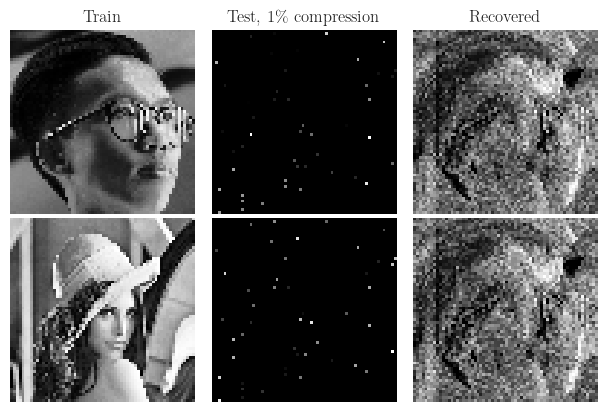

loss = 214.9267120361328 
 psnr = 13.00789737701416 
 ssim = 0.3948107361793518 
 tv = 2116.903564453125


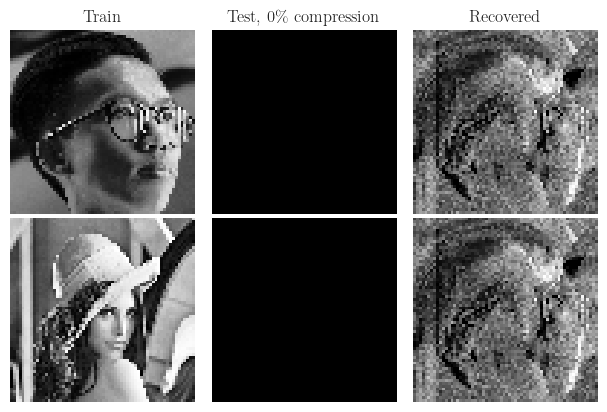

loss = 173.0281524658203 
 psnr = 13.952597618103027 
 ssim = 0.45548683404922485 
 tv = 2296.5810546875


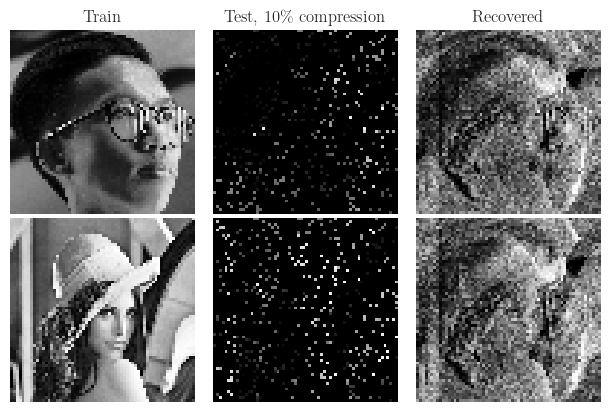

loss = 146.6194610595703 
 psnr = 14.63372802734375 
 ssim = 0.49487531185150146 
 tv = 2191.02978515625


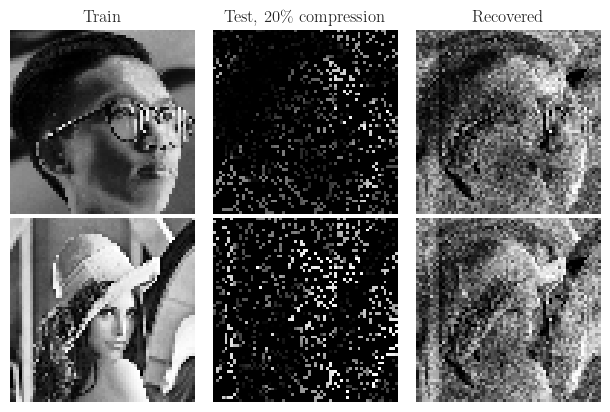

loss = 113.29718017578125 
 psnr = 15.765335083007812 
 ssim = 0.5693527460098267 
 tv = 1962.188232421875


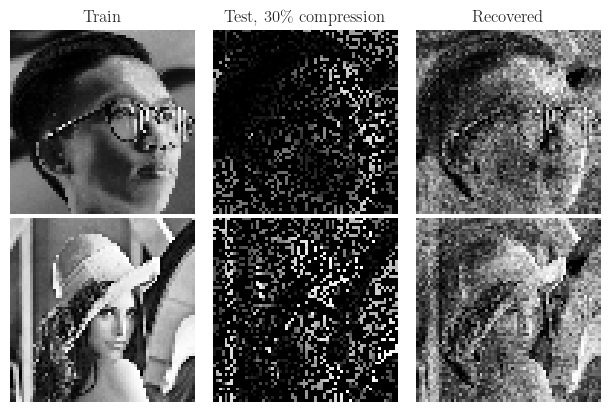

loss = 99.29026794433594 
 psnr = 16.217744827270508 
 ssim = 0.5942633748054504 
 tv = 1872.075439453125


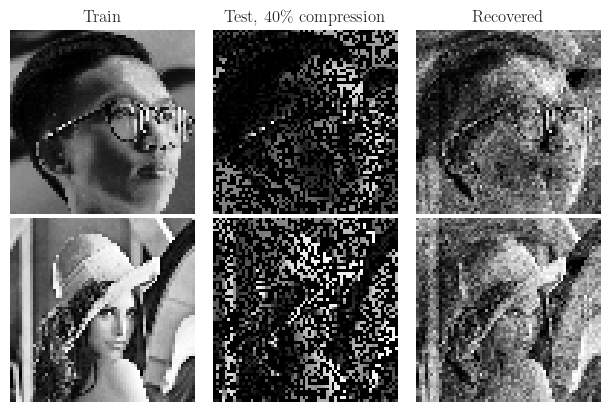

loss = 84.41941833496094 
 psnr = 17.054126739501953 
 ssim = 0.6494233012199402 
 tv = 1676.7095947265625


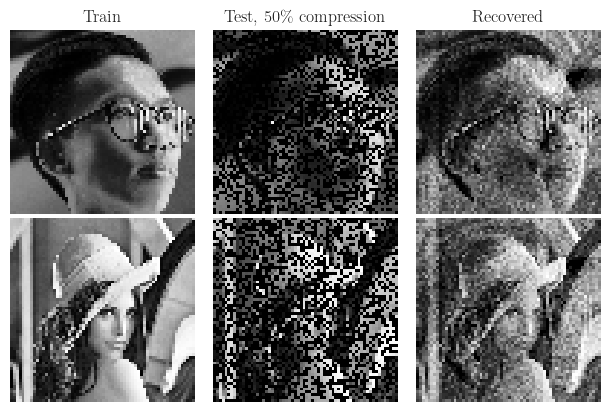

loss = 58.533119201660156 
 psnr = 18.689189910888672 
 ssim = 0.7172602415084839 
 tv = 1485.892822265625


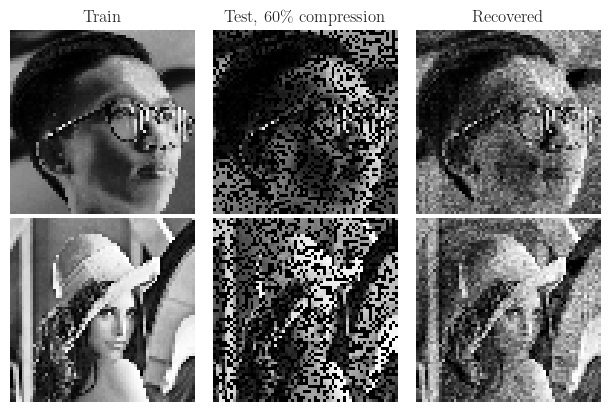

loss = 46.355865478515625 
 psnr = 19.800430297851562 
 ssim = 0.7612019181251526 
 tv = 1367.470703125


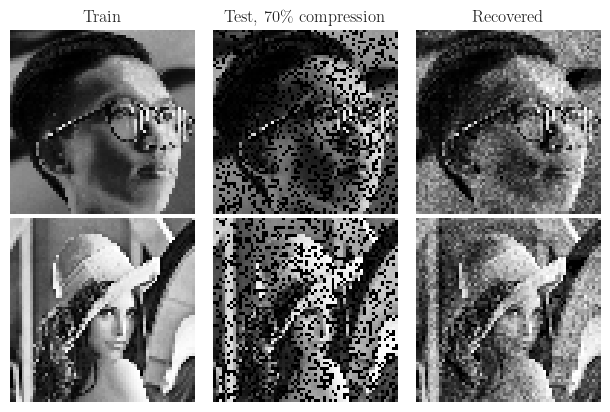

loss = 33.35625076293945 
 psnr = 21.258298873901367 
 ssim = 0.8094925880432129 
 tv = 1174.261962890625


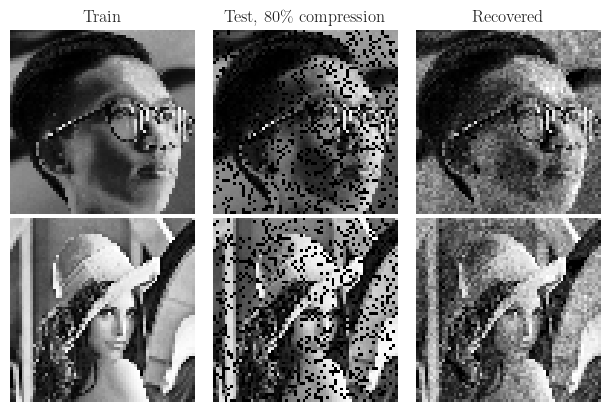

loss = 13.848994255065918 
 psnr = 24.720664978027344 
 ssim = 0.8779088854789734 
 tv = 885.1836547851562


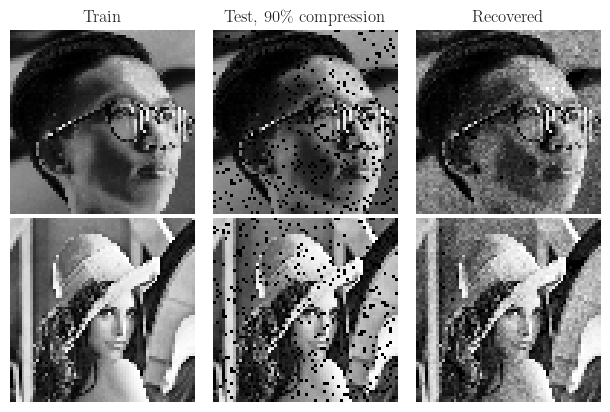

loss = 0.09395484626293182 
 psnr = 48.297828674316406 
 ssim = 0.9989774227142334 
 tv = 2.943906784057617


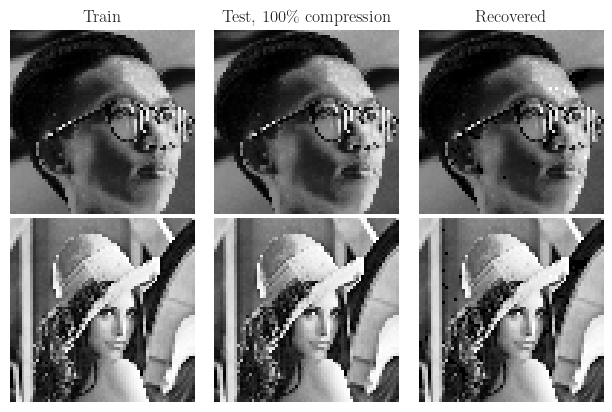

In [25]:
for p in np.concatenate(([0.01], np.arange(0.0, 1.1, 0.1))):
    mask = rand.choice([0, 1], size=(64, 64, 1), p=[1-p, p])
    x_test = np.array([x_train0[i]*mask for i in range(len(x_train0))])

    rec = hebb.predict(x_test/255)
    rec = (rec*255).astype('uint8')
    met = hebb.test_on_batch(x_train0/255, rec/255)

    print('loss = {} \n psnr = {} \n ssim = {} \n tv = {}'.format(*met))

    fig, ax = mp.subplots(2, 3, figsize=(6, 4))
    # ax = np.expand_dims(ax, 0)
    for i in range(2):
        if i == 0:
            ax[i, 0].set_title('Train')
            ax[i, 1].set_title('Test, {}\% compression'.format(int(p*100)))
            ax[i, 2].set_title('Recovered')
        ax[i, 0].imshow(x_train0[i,:,:,0], 'gray')
        ax[i, 0].axis('off')
        ax[i, 1].imshow(x_test[i,:,:,0], 'gray')
        ax[i, 1].axis('off')
        ax[i, 2].imshow(rec[i,:,:,0], 'gray')
        ax[i, 2].axis('off')

    mp.savefig(sessiondir + 'hiseq2inputs_hebb_{}pcratio.png'.format(int(p*100)),
               dpi=300,
               bbox_inches='tight',
               transparent=True)
    mp.grid(False)
    mp.tight_layout(pad=0.2)
    mp.show()

In [26]:
mp.figure()
# mp.plot(history.epoch, history.history['val_loss'])
mp.plot(history.epoch, history.history['loss'])
mp.xlabel('epoch')
mp.ylabel('loss')
# mp.legend(['val', 'train'])
# mp.savefig('190904-hebb-loss.png', 
#            dpi=300, 
#            bbox_inches='tight', 
#            transparent=True)
mp.show()

mp.figure()
# mp.plot(history.epoch, history.history['val_psnr'])
mp.plot(history.epoch, history.history['psnr'])
mp.xlabel('epoch')
mp.ylabel('PSNR')
# mp.legend(['val', 'train'])
# mp.savefig('190904-hebb-psnr.png', 
#            dpi=300, 
#            bbox_inches='tight', 
#            transparent=True)
mp.show()

mp.figure()
# mp.plot(history.epoch, history.history['val_ssim'])
mp.plot(history.epoch, history.history['ssim'])
mp.xlabel('epoch')
mp.ylabel('SSIM')
# mp.legend(['val', 'train'])
# mp.savefig('190904-hebb-ssim.png', 
#            dpi=300, 
#            bbox_inches='tight', 
#            transparent=True)
mp.show()

mp.figure()
# mp.plot(history.epoch, history.history['val_tv'])
mp.plot(history.epoch, history.history['tv'])
mp.xlabel('epoch')
mp.ylabel('TV')
# mp.legend(['val', 'train'])
# mp.savefig('190904-hebb-tv.png', 
#            dpi=300, 
#            bbox_inches='tight', 
#            transparent=True)
mp.show()

NameError: name 'history' is not defined

<Figure size 800x450 with 0 Axes>